# Analysis of NYC public schools results in ELA and math grades 3-8.

<span style="color: red;">**If kernel can't connect to server again run command:**
*netsh winsock reset*<span>

<a id="TOC"></a> 
## Table of Contents
1. [Data sources and definitions](#data)
2. [Imports: modules](#modules)
3. [Read and prepare data](#read)
4. [Best middle schools by math](#best)
5. [Maps of middle schools by math results](#maps) 


<a id="data"></a> 
#### Data:
1. Data New York City grades 3-8 New York State English Language Arts and Math State Tests results 2013-2023:<br>https://infohub.nyced.org/reports/academics/test-results
2. NYS schools locations:<br>
https://data.gis.ny.gov/maps/b6c624c740e4476689aa60fdc4aacb8f/about

#### Definitions of Performance Levels for the 2023 Grades 3-8 English Language Arts and Mathematics Tests  

**NYS Level 1**: Students performing at this level are below proficient in standards for their grade. They may demonstrate limited knowledge, skills, and practices embodied by the Learning Standards that are considered insufficient for the expectations at this grade. 

**NYS Level 2**: Students performing at this level are partially proficient in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered partial but insufficient for the expectations at this grade. Students performing at Level 2 are considered on track to meet current New York high school graduation requirements but are not yet proficient in Learning Standards at this grade. 

**NYS Level 3**: Students performing at this level are proficient in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered sufficient for the expectations at this grade.  

**NYS Level 4**: Students performing at this level excel in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered more than sufficient for the expectations at this grade.  

*Source: NYSED, 2023, https://www.p12.nysed.gov/irs/ela-math/2023/ela-math-score-ranges-performance-levels-2023.pdf*

<a id="modules"></a> 
#### Imports: modules

In [4]:
import os
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from shapely.geometry import Point
import difflib
from fuzzywuzzy import process
import fuzzywuzzy
import base64
from io import BytesIO

pd.set_option('display.float_format', '{:.3f}'.format)

<a id="read"></a> 
#### Read data

In [5]:
basePath = r"G:\My Drive\Kids\NY school"

#Read math results
fileName_math = "school-math-results-2013-2023-(public).xlsx"
mathPath = os.path.join(basePath,fileName_math)
print(mathPath)
sheetName_math = "All"
mathResultsDF = pd.read_excel(mathPath, sheetName_math)

#Read ELA results
fileName_ELA = "school-ela-results-2013-2023-(public).xlsx"
ELAPath = os.path.join(basePath,fileName_ELA)
print(ELAPath)
sheetName_ELA = "All"
ELAResultsDF = pd.read_excel(ELAPath, sheetName_ELA)

G:\My Drive\Kids\NY school\school-math-results-2013-2023-(public).xlsx
G:\My Drive\Kids\NY school\school-ela-results-2013-2023-(public).xlsx


In [8]:
subjects = ['Math', 'ELA']
resultsDFs = {'Math': mathResultsDF, 'ELA': ELAResultsDF}

In [19]:
# resultsDF.info() showed that most of the columns are objects instead of numbers and needed to be converted
for subject in subjects:
    resultsDF = resultsDFs[subject]
    resultsDF_colToConvert = ['Mean Scale Score',
     'Grade',                             
     '# Level 1',
     '% Level 1',
     '# Level 2',
     '% Level 2',
     '# Level 3',
     '% Level 3',
     '# Level 4',
     '% Level 4',
     '# Level 3+4',
     '% Level 3+4']
    resultsDF[resultsDF_colToConvert] = resultsDF[resultsDF_colToConvert].apply(pd.to_numeric, errors = 'coerce')
    resultsDF.info()
    
del resultsDF

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41918 entries, 0 to 41917
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   DBN               41918 non-null  object 
 1   School Name       41918 non-null  object 
 2   Grade             32173 non-null  float64
 3   Year              41918 non-null  int64  
 4   Category          41918 non-null  object 
 5   Number Tested     41918 non-null  int64  
 6   Mean Scale Score  41559 non-null  float64
 7   # Level 1         41559 non-null  float64
 8   % Level 1         41559 non-null  float64
 9   # Level 2         41559 non-null  float64
 10  % Level 2         41559 non-null  float64
 11  # Level 3         41559 non-null  float64
 12  % Level 3         41559 non-null  float64
 13  # Level 4         41559 non-null  float64
 14  % Level 4         41559 non-null  float64
 15  # Level 3+4       41559 non-null  float64
 16  % Level 3+4       41559 non-null  float6

## Analysis

<a id="best"></a> 
### Select Best Middle Schools in the NYC by Math Test Results

#### Prepare dataframe with only middle school results (grades 6-8)

In [20]:
resultsMS_bySchl_Norm ={}

for subject in subjects:
    
    resultsDF = resultsDFs[subject]
    
    # Dataframe with only grades 6-8 results (middle schools and K-8) by years
    resultsMS_bySchl = resultsDF[(resultsDF['Grade'] >= 6)&(resultsDF['Grade'] <= 8)]
    resultsMS_bySchl = resultsMS_bySchl.groupby(['DBN', 'School Name', 'Year'])[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
    # Dataframe for middle schools by years with normalized values
    resultsMS_bySchl_Norm[subject] = resultsMS_bySchl.div(resultsMS_bySchl.sum(axis=1), axis=0)
    resultsMS_bySchl_Norm[subject].reset_index(inplace=True)
    print(resultsMS_bySchl_Norm[subject].head())
    
del resultsDF, resultsMS_bySchl

      DBN                     School Name  Year  # Level 1  # Level 2  \
0  01M015       P.S. 015 ROBERTO CLEMENTE  2023        NaN        NaN   
1  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2013      0.302      0.416   
2  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2014      0.336      0.375   
3  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2015      0.361      0.392   
4  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2016      0.420      0.408   

   # Level 3  # Level 4  
0        NaN        NaN  
1      0.195      0.087  
2      0.230      0.059  
3      0.190      0.057  
4      0.127      0.045  
      DBN                     School Name  Year  # Level 1  # Level 2  \
0  01M015       P.S. 015 ROBERTO CLEMENTE  2023        NaN        NaN   
1  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2013      0.366      0.524   
2  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2014      0.301      0.477   
3  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2015      0.250      0.461   
4  01M034  P.S. 034 FRANKLIN D. ROOSEVEL

#### Select schools with the best results for all middle school grades in 2023

In [21]:
for subject in subjects:
    
    resultsMS_bySchl_sorted = resultsMS_bySchl_Norm[subject].sort_values(by = ['Year', '# Level 4'], ascending=[False, False])
    print(resultsMS_bySchl_sorted.head(50))

    resultsMS_bySchl_sorted.head(50).to_csv(f'50_schools_with_highest_level4_share_{subject}2023.csv', index = True)
    
del resultsMS_bySchl_sorted

         DBN                                        School Name  Year  \
413   03M334                                THE ANDERSON SCHOOL  2023   
72    01M539  NEW EXPLORATIONS INTO SCIENCE, TECHNOLOGY AND ...  2023   
440   03M859                               SPECIAL MUSIC SCHOOL  2023   
2736  21K098                                I.S. 98 BAY ACADEMY  2023   
2628  20K187              THE CHRISTA MCAULIFFE SCHOOL\I.S. 187  2023   
4069  30Q300              THE 30TH AVENUE SCHOOL (G&T CITYWIDE)  2023   
476   04M012                                 TAG YOUNG SCHOLARS  2023   
27    01M184                               P.S. 184M SHUANG WEN  2023   
207   02M312  NEW YORK CITY LAB MIDDLE SCHOOL FOR COLLABORATIVE  2023   
3961  30Q122                                 P.S. 122 MAMIE FAY  2023   
4078  30Q580          BACCALAUREATE SCHOOL FOR GLOBAL EDUCATION  2023   
3373  26Q074                     J.H.S. 074 NATHANIEL HAWTHORNE  2023   
105   02M114                            EAST SIDE M

#### Select schools with the best math results for all middle school grades in 2013-2023

In [40]:
# Select top 50 schools by average test results 2013-2023
resultsMS_top50_AVG2013_23 = {}

for subject in subjects:
    
    resultsDF = resultsDFs[subject]
    # Dataframe with only grades 6-8 results (middle schools and K-8) by schools
    resultsMS_bySchl_sumed = resultsDF[(resultsDF['Grade'] >= 6)&(resultsDF['Grade'] <= 8)].groupby(['DBN', 'School Name'])[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
    # Dataframe for middle schools by years with normalized values
    resultsMS_bySchl_sumed_Norm = resultsMS_bySchl_sumed.div(resultsMS_bySchl_sumed.sum(axis=1), axis=0)
    resultsMS_bySchl_sumed_sorted = resultsMS_bySchl_sumed_Norm.sort_values(by = '# Level 4', ascending=False)
    resultsMS_bySchl_sumed_sorted.reset_index(inplace=True)
    resultsMS_top50_AVG2013_23[subject] = resultsMS_bySchl_sumed_sorted.head(50)
    #print(resultsMS_bySchl_sumed_sorted.head(50))
    #resultsMS_bySchl_sumed_sorted.head(50).to_csv(f'50_schools_with_highest_level4_share_{subject}2013-2023.csv', index = True)

del resultsDF, resultsMS_bySchl_sumed_Norm, resultsMS_bySchl_sumed_sorted

In [36]:
for subject in subjects:
    resultsMS_top50_AVG2013_23[subject].head(3)

<a id="maps"></a> 
### Maps of the NYC middle schools by assessment results 

Below mapping is done with the __[Folium library](https://python-visualization.github.io/folium/latest/)__

#### Read schools geolocation file

In [24]:
## Read GeoJSON into data frame
SchoolsFile = 'NYC_K-12_schools_public.geojson'
NYCSchoolsPath = os.path.join(basePath, SchoolsFile)
NYCSchoolsData = gpd.read_file(NYCSchoolsPath)

DistrictsFile = 'School Districts.geojson'
NYCDistrictsPath = os.path.join(basePath, DistrictsFile)
NYCDistrictsData = gpd.read_file(NYCDistrictsPath)
#NYCSchoolsData.head()

#### Merge the GeoJSON and the results dataframe

In [25]:
#NYCSchoolsData.info() #Too many columns --> make a smaller copy
NYCSchoolsDataShort = NYCSchoolsData[['OBJECTID', 'LEGAL_NAME', 'PHYSADDRLINE1', 'PHYSCITY', 'COUNTY_DESC', 'RECORD_TYPE_DESC', 'SDL_DESC', 'geometry']]
NYCSchoolsDataShort.head()

,OBJECTID,LEGAL_NAME,PHYSADDRLINE1,PHYSCITY,COUNTY_DESC,RECORD_TYPE_DESC,SDL_DESC,geometry
0,54,PS 11 THOMAS DONGAN SCHOOL,85 GARRETSON AVE,STATEN ISLAND,RICHMOND,PUBLIC SCHOOL (IMF),NYC GEOG DIST 31,POINT (576322.056 4493696.890)
1,55,SCHOOL WITHOUT WALLS,207 TRINITY PL,NEW YORK,NEW YORK,PUBLIC SCHOOL (IMF),NYC GEOG DIST 2,POINT (583425.686 4506914.562)
2,131,YOUNG WOMEN'S LEADERSHIP SCHOOL,140 W 140TH ST,NEW YORK,NEW YORK,PUBLIC SCHOOL (IMF),NYC GEOG DIST 4,POINT (589347.579 4519091.922)
3,132,EDWARD A REYNOLDS WEST SIDE HIGH SCHOOL,105 E 106TH ST,NEW YORK,NEW YORK,PUBLIC SCHOOL (IMF),NYC GEOG DIST 3,POINT (588814.806 4516292.893)
4,134,ASPIRATIONS DIPLOMA PLUS HIGH SCHOOL,1150 E NEW YORK AVE,BROOKLYN,KINGS,PUBLIC SCHOOL (IMF),NYC GEOG DIST 17,POINT (590940.002 4502277.994)


In [ ]:
# Function to match names
def match_name(name, list_names, min_score=0):
    max_score = -1
    max_name = ''
    for x in list_names:
        score = process.extractOne(name, [x], scorer=fuzzywuzzy.fuzz.token_sort_ratio)[1]
        if score > max_score and score >= min_score:
            max_name = x
            max_score = score
    return max_name

In [26]:
# Matching the full test results files with spatial data (geojson of schools locations)

resultsDFs_mappable = {}

for subject in subjects:
    # Matching names from resultsMS_bySchl_Norm[subject] to NYCSchoolsDataShort
    resultsMS_bySchl_Norm[subject]['matched_name'] = resultsMS_bySchl_Norm[subject]['School Name'].apply(lambda x: match_name(x, NYCSchoolsDataShort['LEGAL_NAME'], min_score=80))

    # Merging DataFrames based on the matched name
    resultsDFs_mappable[subject] = pd.merge(NYCSchoolsDataShort, resultsMS_bySchl_Norm[subject], left_on='LEGAL_NAME', right_on='matched_name')
    resultsDFs_mappable[subject].to_file(f"NYCpublicSchools{subject}.geojson", driver="GeoJSON")


In [27]:
for subject in subjects:
    print(resultsMS_bySchl_Norm[subject]['matched_name'].isnull().sum())

0
0


In [ ]:
for subject in subjects:
    print(resultsDFs_mappable[subject].info())

In [29]:
# Select top 50 middle schools by share of level 4 results in 2023 from geojson

for subject in subjects:
    
    resultsDF_map = resultsDFs_mappable[subject]
    sortedDF = resultsDF_map.sort_values(by = ['Year', '# Level 4'], ascending=[False, False])
    sortedDF.head(50).to_file(f"NYCpublicSchools{subject}Top50.geojson", driver="GeoJSON")

In [51]:
# Make geojsons for to top 50 schools by average 2013-2023 results

top50AVGDFs_mappable = {}

for subject in subjects:
    # Matching names from resultsMS_top50_AVG2013_23[subject] to NYCSchoolsDataShort
    resultsMS_top50_AVG2013_23[subject]['matched_name'] = resultsMS_top50_AVG2013_23[subject]['School Name'].apply(lambda x: match_name(x, NYCSchoolsDataShort['LEGAL_NAME'], min_score=80))

    # Merging DataFrames based on the matched name
    top50AVGDFs_mappable[subject] = pd.merge(NYCSchoolsDataShort, resultsMS_top50_AVG2013_23[subject], left_on='LEGAL_NAME', right_on='matched_name')
    #top50AVGDFs_mappable[subject].to_file(f"NYCtop50AVG2013_23{subject}.geojson", driver="GeoJSON")  

In [42]:
 resultsMS_top50_AVG2013_23[subject].head(3)

,DBN,School Name,# Level 1,# Level 2,# Level 3,# Level 4,matched_name
0,30Q122,P.S. 122 MAMIE FAY,0.008,0.019,0.168,0.805,PS 122 MAMIE FAY
1,30Q300,THE 30TH AVENUE SCHOOL (G&T CITYWIDE),0.008,0.036,0.153,0.802,30TH AVENUE SCHOOL (THE) (G & T CITYWIDE)
2,03M334,THE ANDERSON SCHOOL,0.001,0.030,0.169,0.799,ANDERSON SCHOOL (THE)


In [52]:
top50AVGDFs_mappable['Math'].head()

,OBJECTID,LEGAL_NAME,PHYSADDRLINE1,PHYSCITY,COUNTY_DESC,RECORD_TYPE_DESC,SDL_DESC,geometry,DBN,School Name,# Level 1,# Level 2,# Level 3,# Level 4,matched_name
0,442,EAST-WEST SCHOOL OF INTERNATIONAL STUDIES,46-21 COLDEN ST,FLUSHING,QUEENS,PUBLIC SCHOOL (IMF),NYC GEOG DIST 25,POINT (599485.252 4511595.422),25Q281,EAST-WEST SCHOOL OF INTERNATIONAL STUDIES,0.092,0.192,0.286,0.430,EAST-WEST SCHOOL OF INTERNATIONAL STUDIES
1,477,QUEENS GATEWAY TO HEALTH SCIENCES SECONDARY SC...,160-20 GOETHALS AVE,JAMAICA,QUEENS,PUBLIC SCHOOL (IMF),NYC GEOG DIST 28,POINT (600833.295 4508206.563),28Q680,QUEENS GATEWAY TO HEALTH SCIENCES SECONDARY SC...,0.059,0.174,0.299,0.468,QUEENS GATEWAY TO HEALTH SCIENCES SECONDARY SC...
2,506,MATH AND SCIENCE EXPLORATORY SCHOOL (THE),345 DEAN ST,BROOKLYN,KINGS,PUBLIC SCHOOL (IMF),NYC GEOG DIST 15,POINT (586154.555 4504151.629),15K447,THE MATH & SCIENCE EXPLORATORY SCHOOL,0.043,0.198,0.322,0.437,MATH AND SCIENCE EXPLORATORY SCHOOL (THE)
3,539,CLINTON SCHOOL (THE),10 E 15TH ST,NEW YORK,NEW YORK,PUBLIC SCHOOL (IMF),NYC GEOG DIST 2,POINT (585081.419 4509968.226),02M260,THE CLINTON SCHOOL,0.058,0.184,0.336,0.422,CLINTON SCHOOL (THE)
4,548,ANDERSON SCHOOL (THE),100 W 77TH ST,NEW YORK,NEW YORK,PUBLIC SCHOOL (IMF),NYC GEOG DIST 3,POINT (586241.523 4514963.488),03M334,THE ANDERSON SCHOOL,0.004,0.026,0.123,0.847,ANDERSON SCHOOL (THE)


C:\Users\Student\anaconda3\envs\AC37\lib\site-packages\pandas\plotting\_matplotlib\core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


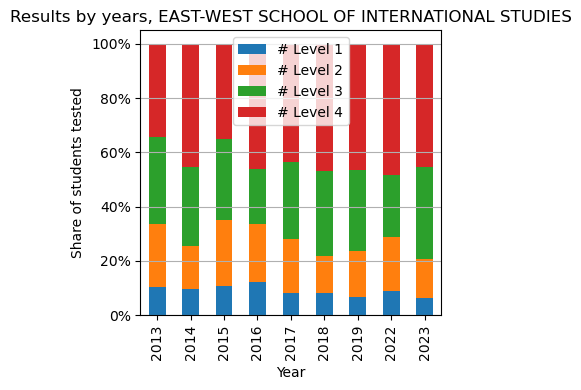

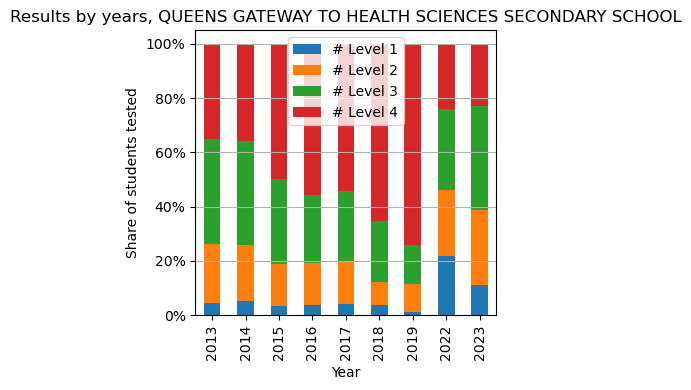

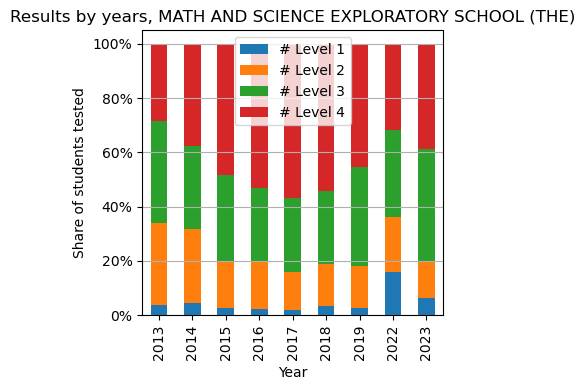

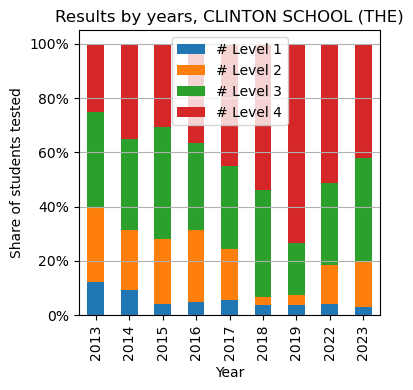

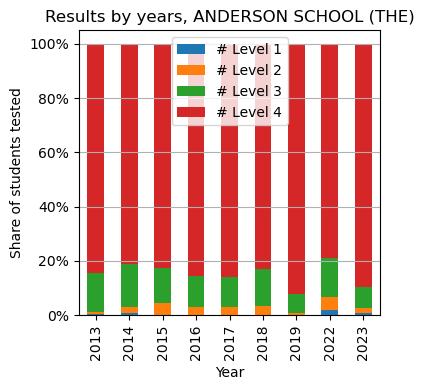

...

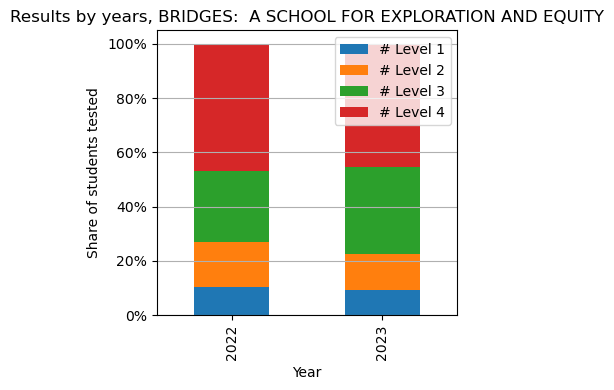

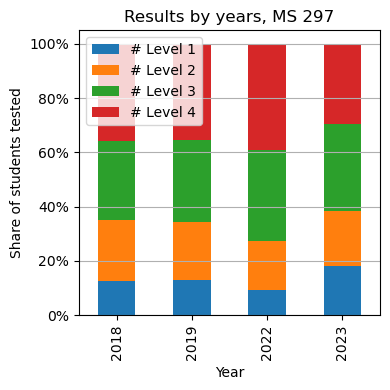

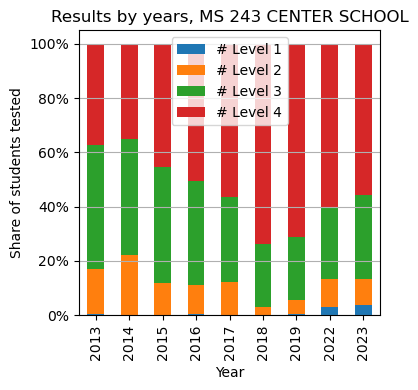

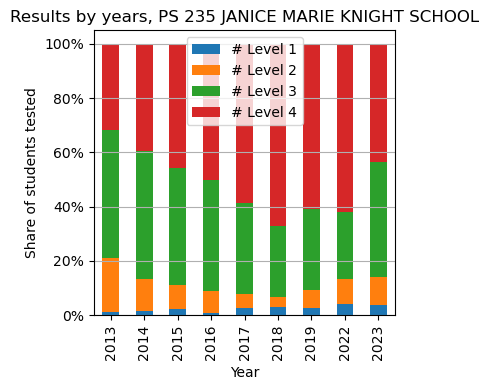

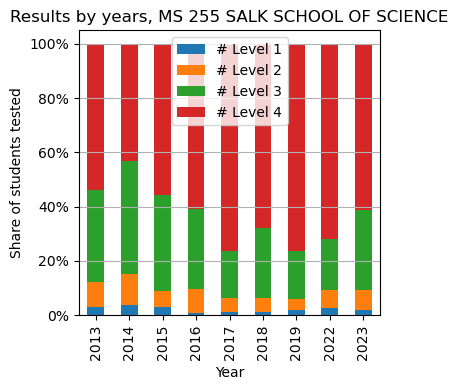

In [54]:
# Make plots for popups in the map for top 50 schools

columns_to_plot = ["# Level 1", "# Level 2", "# Level 3", "# Level 4"]   

# Function that creates a plot
def create_plot(dataframe, name):
    plot_data = dataframe.set_index('Year')[columns_to_plot]
    plot_data.plot(kind='bar', stacked=True, figsize=(4,4))
    title = 'Results by years, ' + name
    plt.title(title)  # Set the title
    plt.xlabel('Year')  # X-axis label
    plt.ylabel('Share of students tested')  # Y-axis label
    plt.grid(axis='y')
    plt.yticks([0, 0.2, 0.4, 0.6, 0.8, 1.0], ['0%', '20%', '40%', '60%', '80%', '100%'])  # Adjust y-ticks to percentage
    plt.tight_layout()
    # Return the figure object for further use
    return plt.gcf()  # gcf - Get Current Figure

top50AVGDFs_mappable_plots = {}

# list of schools names
for subject in subjects:
    schoolsNames = top50AVGDFs_mappable[subject]['LEGAL_NAME'].to_list()
    testResults = resultsDFs_mappable[subject]
    
    # Create disctionnary to hold the dataframes by schools
    schoolDFs = {}
    
    # Make dataframes by schools 
    for name in schoolsNames:
        dfName = name
        schoolDFs[dfName] = testResults[testResults['LEGAL_NAME'] == name]
    
    plots = []
    
    # Plot dataframes by school
    for schoolDF, current_dataframe in schoolDFs.items():
        # schoolDF contains the name of the dataframe
        # current_dataframe contains the dataframe itself
        # Do something with current_dataframe
        # Create a plot
        fig = create_plot(current_dataframe, schoolDF)

        # Convert the plot to a PNG image and then encode it
        io_buf = BytesIO()
        fig.savefig(io_buf, format='png')
        io_buf.seek(0)
        base64_string = base64.b64encode(io_buf.read()).decode('utf8')

        pair = (schoolDF, base64_string)

        plots.append(pair)

        # add the plots to the geodataframe of 50 top middle schools by math results 
        plotsDF = pd.DataFrame(plots, columns=['LEGAL_NAME', 'plot'])
        top50AVGDFs_mappable_plots[subject] = pd.merge(DF_mappable, plotsDF, left_on = 'LEGAL_NAME', right_on='LEGAL_NAME')

C:\Users\Student\anaconda3\envs\AC37\lib\site-packages\pandas\plotting\_matplotlib\core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


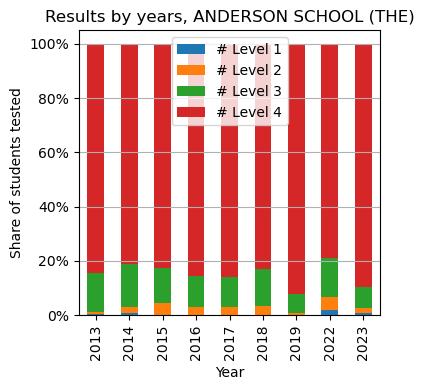

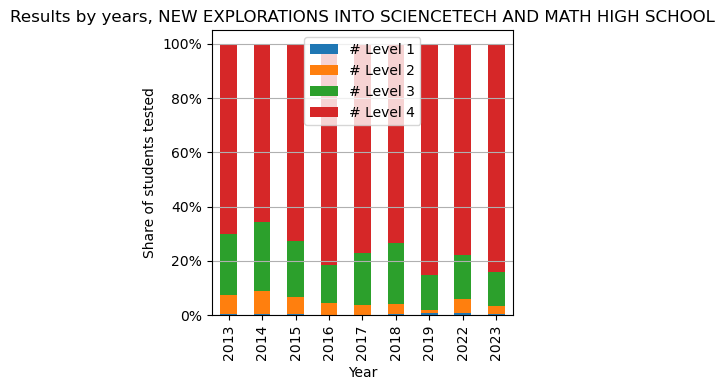

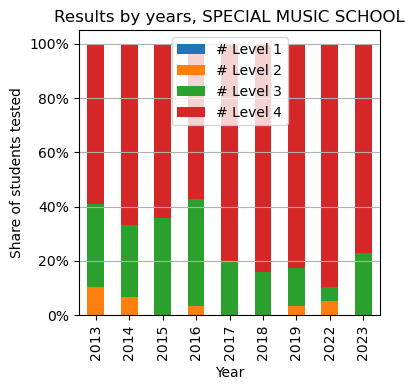

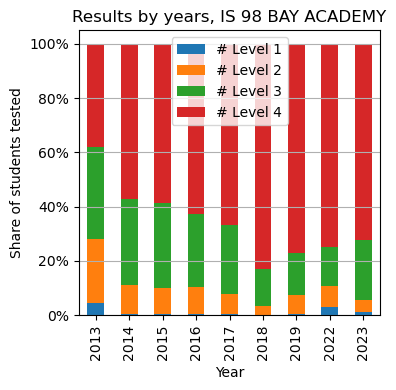

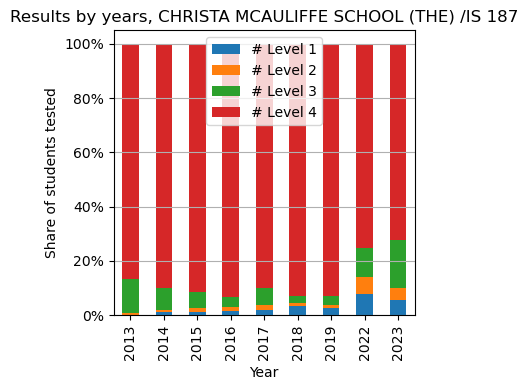

...

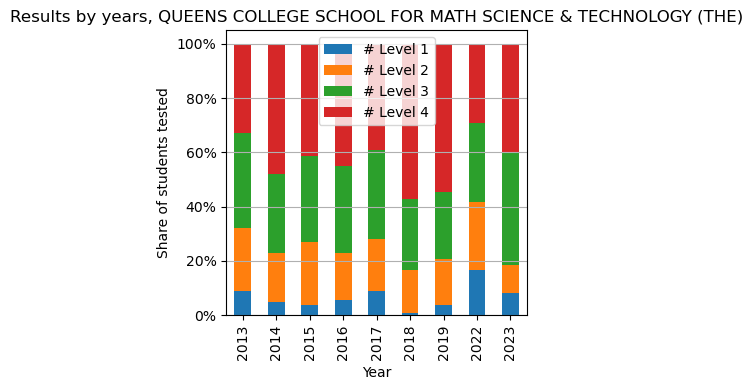

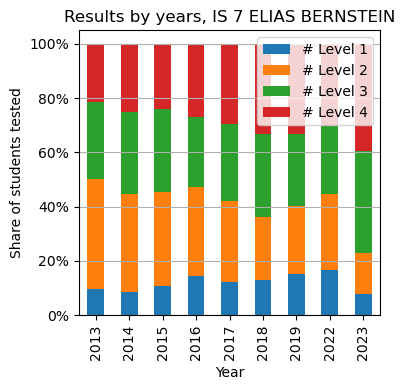

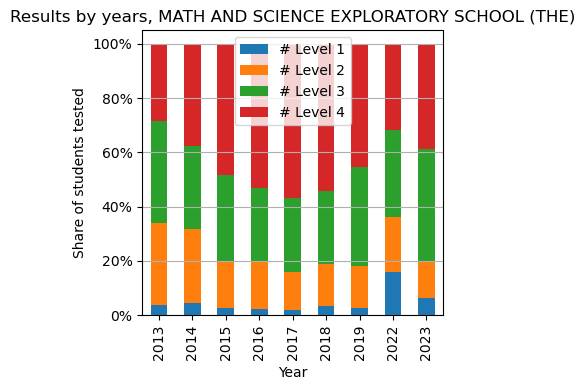

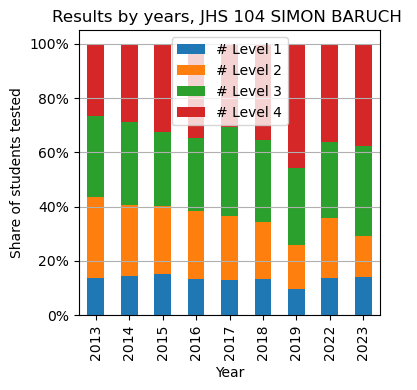

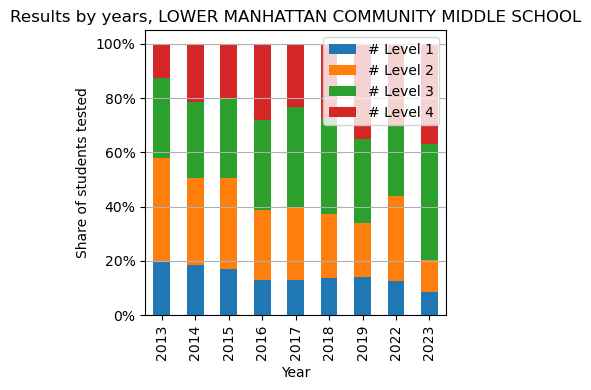

In [112]:
# Make plots for popups in the map for top 50 schools
    
# list of schools names
schoolsNames = MathTop50Data['LEGAL_NAME'].to_list()

# Create disctionnary to hold the dataframes by schools
schoolDFs = {}

# Make dataframes by schools 
for name in schoolsNames:
    dfName = name
    schoolDFs[dfName] = MathTop50History_mappable[MathTop50History_mappable['LEGAL_NAME'] == name]
    
columns_to_plot = ["# Level 1", "# Level 2", "# Level 3", "# Level 4"]    
    
def create_plot(dataframe, name):
    plot_data = dataframe.set_index('Year')[columns_to_plot]
    plot_data.plot(kind='bar', stacked=True, figsize=(4,4))
    title = 'Results by years, ' + name
    plt.title(title)  # Set the title
    plt.xlabel('Year')  # X-axis label
    plt.ylabel('Share of students tested')  # Y-axis label
    plt.grid(axis='y')
    plt.yticks([0, 0.2, 0.4, 0.6, 0.8, 1.0], ['0%', '20%', '40%', '60%', '80%', '100%'])  # Adjust y-ticks to percentage
    plt.tight_layout()
    # Return the figure object for further use
    return plt.gcf()  # gcf - Get Current Figure

plots = []

# Plot dataframes by school
for schoolDF, current_dataframe in schoolDFs.items():
    # schoolDF contains the name of the dataframe
    # current_dataframe contains the dataframe itself
    # Do something with current_dataframe
    # Create a plot
    fig = create_plot(current_dataframe, schoolDF)

    # Convert the plot to a PNG image and then encode it
    io_buf = BytesIO()
    fig.savefig(io_buf, format='png')
    io_buf.seek(0)
    base64_string = base64.b64encode(io_buf.read()).decode('utf8')
    
    pair = (schoolDF, base64_string)

    plots.append(pair)


In [114]:
# add the plots to the geodataframe of 50 top middle schools by math results 
plotsDF = pd.DataFrame(plots, columns=['LEGAL_NAME', 'plot'])
MathTop50Data_withPlots = pd.merge(MathTop50Data, plotsDF, left_on = 'LEGAL_NAME', right_on='LEGAL_NAME')

In [60]:
# Read file with district wide Math test results to add to the map
DistrictMathFile = "DistrictsMSMAthNorm.xlsx"
DistrictMathPath = os.path.join(basePath, DistrictMathFile)
DistrictMSMathData = pd.read_excel(DistrictMathPath)
print(DistrictMSMathData.head(5))

# Read file with district wide ELA test results to add to the map
DistrictELAFile = "DistrictsMSELANorm.xlsx"
DistrictELAPath = os.path.join(basePath, DistrictELAFile)
DistrictMSELAData = pd.read_excel(DistrictELAPath)
print(DistrictMSELAData.head(5))

   Unnamed: 0  Year  # Level 1  # Level 2  # Level 3  # Level 4  District
0           0  2013      0.259      0.310      0.195      0.237         1
1           1  2014      0.256      0.313      0.218      0.214         1
2           2  2015      0.235      0.330      0.206      0.229         1
3           3  2016      0.225      0.330      0.178      0.267         1
4           4  2017      0.293      0.289      0.173      0.245         1
   Unnamed: 0  Year  # Level 1  # Level 2  # Level 3  # Level 4  District
0           0  2013      0.265      0.461      0.465      0.997         1
1           1  2014      0.214      0.438      0.518      0.997         1
2           2  2015      0.216      0.397      0.537      0.997         1
3           3  2016      0.156      0.425      0.535      0.997         1
4           4  2017      0.169      0.395      0.501      0.998         1


In [138]:
# Create a map object, centered at NYC
MathTestMS_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")
 
def my_style(x):
    level4 = x['properties']['# Level 4']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        "radius": (level4)*1000
    }   

def my_top_style(x):
    level4 = x['properties']['# Level 4']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        "radius": (level4)*1000,    
    }  

# Add dataframes with coordinates and test results to the map

## Adding the layer to the map
districts = folium.Choropleth(
    geo_data = NYCDistrictsData,
    data = DistrictMSMathData[DistrictMSMathData['Year'] == 2023],
    columns = ['District','# Level 4'],
    key_on = "feature.properties.school_dist",
    fill_color = "BuPu",
    fill_opacity = 0.8,
    line_opacity=0.3,
    nan_fill_color="white",
    popup = folium.GeoJsonPopup(fields=["school_dist", "Year", "# Level 1", "# Level 2", "# Level 3", "# Level 4"]), 
    legend_name = 'Percent of middle school test takers with Level 4 result',
    name = "School districts"
).add_to(MathTestMS_map)

folium.GeoJson(
    NYCpublicSchoolsMath_mappable[NYCpublicSchoolsMath_mappable['Year'] == 2023],
    marker = folium.Circle(radius=10, fill_color='yellow', fill_opacity=1.0, color="orange", weight=0.5),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    style_function = my_style,        
    zoom_on_click = True,
    name = "All middle schools"
).add_to(MathTestMS_map)


# # Function to create iframe for a given row
# def create_iframe(row):
#     html = '<strong>{0}:</strong> {1}<br><strong>{2}:</strong> {3}<br><img src="data:image/png;base64,{4}">'.format(
#         'School Name', row['LEGAL_NAME'], 
#         'Level 4 share 2023', row['# Level 4'], 
#         row['plot']
#     )
#     return folium.IFrame(html, width=450, height=450)

# # Add popups to each feature in the GeoJson MathTop50Data_withPlots layer
# def create_popup(row):
#     iframe = create_iframe(row)
#     return folium.Popup(iframe)
# # for _, row in MathTop50Data_withPlots.iterrows():
# #     iframe = create_iframe(row)
# #     popup = folium.Popup(iframe)


MathTop50 = folium.GeoJson(
    MathTop50Data_withPlots,
    marker = folium.Circle(radius=10, fill_color='green', fill_opacity=1.0, color="white", weight=0.5),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME", "# Level 4"]),
    style_function = my_top_style, 
    zoom_on_click = True,    
    name = "Top 50 schools by share of Level 4 results"
).add_to(MathTestMS_map)


folium.LayerControl().add_to(MathTestMS_map)
   
# Display the map
MathTestMS_map

In [169]:
from IPython.core.display import display, HTML

display(HTML("<style>.output_scroll { height: auto !important; max-height: 1000px; }</style>"))

# Create a map object, centered at NYC
MathTestMS_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")
   
# Add dataframes with coordinates and test results to the map

def my_style(x):
    level4 = x['properties']['# Level 4']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        "radius": (level4)*1000
    }   

## Adding the layer to the map
districts = folium.Choropleth(
    geo_data = NYCDistrictsData,
    data = DistrictMSMathData[DistrictMSMathData['Year'] == 2023],
    columns = ['District','# Level 4'],
    key_on = "feature.properties.school_dist",
    fill_color = "BuPu",
    fill_opacity = 0.8,
    line_opacity=0.3,
    nan_fill_color="white",
    legend_name = 'Percent of middle school test takers with Level 4 result',
    popup = folium.GeoJsonPopup(fields=["school_dist", "Year", "# Level 1", "# Level 2", "# Level 3", "# Level 4"]), 
    name = "School districts"
).add_to(MathTestMS_map)

folium.GeoJson(
    NYCpublicSchoolsMath_mappable[NYCpublicSchoolsMath_mappable['Year'] == 2023],
    marker = folium.Circle(radius=10, fill_color='yellow', fill_opacity=1.0, color="orange", weight=0.5),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    style_function = my_style,        
    zoom_on_click = True,
    name = "All middle schools"
).add_to(MathTestMS_map)

# Function to create iframe for a given row
def create_iframe(row):    
    html =  '<strong>{0}:</strong> {1}<br><strong>{2}:</strong> {3}<br><img src="data:image/png;base64,{4}">'.format(
        'School Name', row['LEGAL_NAME'], 
        'Level 4 share 2023', row['# Level 4'], 
        row['plot'])
    return folium.IFrame(html, width=450, height=450)

def create_popup(x):
    iframe = create_iframe(x)
    popup = folium.Popup(iframe)
    return popup

# Iterate over the GeoDataFrame and add a popup to each feature
for _, row in MathTop50Data_withPlots.iterrows():
    iframe = create_iframe(row)
        
    data = gpd.GeoDataFrame(row.to_frame().T, crs=MathTop50Data_withPlots.crs)
    
    folium.GeoJson(
    data,
    marker = folium.Circle(radius=10, fill_color='green', fill_opacity=1.0, color="white", weight=0.5),
    popup = folium.Popup(iframe),
    style_function = my_style, 
    control = False    
    #zoom_on_click = True,    
).add_to(MathTestMS_map)    
        
folium.LayerControl().add_to(MathTestMS_map)    
  
# Display the map
MathTestMS_map

In [57]:
from IPython.core.display import display, HTML

display(HTML("<style>.output_scroll { height: auto !important; max-height: 1000px; }</style>"))

# Setting map by subject
subject = 'Math'
allSchoolsDF = resultsDFs_mappable[subject]
top50AVGDF = top50AVGDFs_mappable_plots[subject]

# Create a map object, centered at NYC
MathTestMS_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")
   
# Add dataframes with coordinates and test results to the map

def my_style(x):
    level4 = x['properties']['# Level 4']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        "radius": (level4)*1000
    }   

# Adding the layers to the map

## School districts
districts = folium.Choropleth(
    geo_data = NYCDistrictsData,
    data = DistrictMSMathData[DistrictMSMathData['Year'] == 2023],
    columns = ['District','# Level 4'],
    key_on = "feature.properties.school_dist",
    fill_color = "BuPu",
    fill_opacity = 0.8,
    line_opacity=0.3,
    nan_fill_color="white",
    legend_name = 'Percent of middle school test takers with Level 4 result',
    popup = folium.GeoJsonPopup(fields=["school_dist", "Year", "# Level 1", "# Level 2", "# Level 3", "# Level 4"]), 
    name = "School districts"
).add_to(MathTestMS_map)

# All schoools
folium.GeoJson(
    allSchoolsDF[allSchoolsDF['Year'] == 2023],
    marker = folium.Circle(radius=10, fill_color='yellow', fill_opacity=1.0, color="orange", weight=0.5),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    style_function = my_style,        
    zoom_on_click = True,
    name = "All middle schools"
).add_to(MathTestMS_map)

# Function to create iframe for a given row
def create_iframe(row):    
    html =  '<strong>{0}:</strong> {1}<br><strong>{2}:</strong> {3}<br><img src="data:image/png;base64,{4}">'.format(
        'School Name', row['LEGAL_NAME'], 
        'Level 4 share 2023', row['# Level 4'], 
        row['plot'])
    return folium.IFrame(html, width=450, height=450)

def create_popup(x):
    iframe = create_iframe(x)
    popup = folium.Popup(iframe)
    return popup

# Iterate over the GeoDataFrame and add a popup to each feature
for _, row in top50AVGDF.iterrows():
    iframe = create_iframe(row)
        
    data = gpd.GeoDataFrame(row.to_frame().T, crs=top50AVGDF.crs)
    
    folium.GeoJson(
    data,
    marker = folium.Circle(radius=10, fill_color='green', fill_opacity=1.0, color="white", weight=0.5),
    popup = folium.Popup(iframe),
    style_function = my_style, 
    control = False    
    #zoom_on_click = True,    
).add_to(MathTestMS_map)    
        
folium.LayerControl().add_to(MathTestMS_map)    
  
# Display the map
MathTestMS_map

In [62]:
from IPython.core.display import display, HTML

display(HTML("<style>.output_scroll { height: auto !important; max-height: 1000px; }</style>"))

# Setting map by subject
subject = 'ELA'
allSchoolsDF = resultsDFs_mappable[subject]
top50AVGDF = top50AVGDFs_mappable_plots[subject]

# Create a map object, centered at NYC
ELATestMS_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")
   
# Add dataframes with coordinates and test results to the map

def my_style(x):
    level4 = x['properties']['# Level 4']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        "radius": (level4)*1000
    }   

# Adding the layers to the map

## School districts
districts = folium.Choropleth(
    geo_data = NYCDistrictsData,
    data = DistrictMSMathData[DistrictMSMathData['Year'] == 2023],
    columns = ['District','# Level 4'],
    key_on = "feature.properties.school_dist",
    fill_color = "BuPu",
    fill_opacity = 0.8,
    line_opacity=0.3,
    nan_fill_color="white",
    legend_name = 'Percent of middle school test takers with Level 4 result',
    popup = folium.GeoJsonPopup(fields=["school_dist", "Year", "# Level 1", "# Level 2", "# Level 3", "# Level 4"]), 
    name = "School districts"
).add_to(ELATestMS_map)

# All schoools
folium.GeoJson(
    allSchoolsDF[allSchoolsDF['Year'] == 2023],
    marker = folium.Circle(radius=10, fill_color='yellow', fill_opacity=1.0, color="orange", weight=0.5),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    style_function = my_style,        
    zoom_on_click = True,
    name = "All middle schools"
).add_to(ELATestMS_map)

# Function to create iframe for a given row
def create_iframe(row):    
    html =  '<strong>{0}:</strong> {1}<br><strong>{2}:</strong> {3}<br><img src="data:image/png;base64,{4}">'.format(
        'School Name', row['LEGAL_NAME'], 
        'Level 4 share 2023', row['# Level 4'], 
        row['plot'])
    return folium.IFrame(html, width=450, height=450)

def create_popup(x):
    iframe = create_iframe(x)
    popup = folium.Popup(iframe)
    return popup

# Iterate over the GeoDataFrame and add a popup to each feature
for _, row in top50AVGDF.iterrows():
    iframe = create_iframe(row)
        
    data = gpd.GeoDataFrame(row.to_frame().T, crs=top50AVGDF.crs)
    
    folium.GeoJson(
    data,
    marker = folium.Circle(radius=10, fill_color='green', fill_opacity=1.0, color="white", weight=0.5),
    popup = folium.Popup(iframe),
    style_function = my_style, 
    control = False    
    #zoom_on_click = True,    
).add_to(ELATestMS_map)    
        
folium.LayerControl().add_to(ELATestMS_map)    
  
# Display the map
ELATestMS_map

In [59]:
mathResultsMS_mappable.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 148 entries, 0 to 147
Data columns (total 25 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   OBJECTID             148 non-null    int64   
 1   LEGAL_NAME           148 non-null    object  
 2   PHYSADDRLINE1        148 non-null    object  
 3   PHYSADDRLINE2        148 non-null    object  
 4   PHYSCITY             148 non-null    object  
 5   PHYSICALSTATE        148 non-null    object  
 6   PHYSZIPCD5           148 non-null    object  
 7   COUNTY_DESC          148 non-null    object  
 8   Contact_Name         148 non-null    object  
 9   CEO_TITLE            148 non-null    object  
 10  CEO_PHONENUM         147 non-null    object  
 11  CEO_EMAIL            148 non-null    object  
 12  INST_TYPE_DESC       148 non-null    object  
 13  INSTSUBTYPDESC       148 non-null    object  
 14  RECORD_TYPE_DESC     148 non-null    object  
 15  COMMUNITY_TYPE_

In [40]:
# Create a map object, centered at NYC
Schools_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")

# Add GeoJSON with public schools to the map
## Read GeoJSON into data frame
SchoolsFile = 'NYC_K-12_schools_public.geojson'
NYCSchoolsPath = os.path.join(basePath, SchoolsFile)
NYCSchoolsData = gpd.read_file(NYCSchoolsPath)

NYCSchoolsData_uniqueTypes = NYCSchoolsData['RECORD_TYPE_DESC'].unique().tolist()
colors = ["green", "blue"]
colorsType = dict(zip(NYCSchoolsData_uniqueTypes, colors))

## Set marker style
def my_marker_style(x): 
    record_type = x['properties'].get('RECORD_TYPE_DESC', 'Default')
    color = colorsType.get(record_type, "#FFFFFF")  # Default to white if type not found
    return {"fillColor": color}


## Adding the layer to the map
folium.GeoJson(
    NYCSchoolsData,
    marker = folium.Circle(radius=10, fill_color="orange", fill_opacity=1.0, color="orange", weight=0),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME","RECORD_TYPE_DESC"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME","RECORD_TYPE_DESC"]),
    style_function = my_marker_style,
    zoom_on_click = True,
).add_to(Schools_map)

# Display the map
Schools_map

In [42]:
colorsType

{'PUBLIC SCHOOL (IMF)': 'green', 'PUBLIC SCHOOL (NON-IMF)': 'blue'}

In [4]:
# Reading with data from NYS: https://data.nysed.gov/downloads.php
basePath = r"D:\.shortcut-targets-by-id\1c4wCBVjOg0tiW0xxI4zE2Wjj1FnzKBJL\Kids\NY school"
fileName_mathNYS = "NYC_MATH_2022-2023_from_NYS.xlsx"
mathPathNYS = os.path.join(basePath,fileName_mathNYS)
print(mathPathNYS)

mathResultsNYSDF = pd.read_excel(mathPathNYS)

D:\.shortcut-targets-by-id\1c4wCBVjOg0tiW0xxI4zE2Wjj1FnzKBJL\Kids\NY school\NYC_MATH_2022-2023_from_NYS.xlsx


In [60]:
mathResultsNYSDF.head()
#mathResultsNYSDF['ASSESSMENT_NAME'].unique().tolist()
#NYCSchoolsData.head()

,ENTITY_NAME,YEAR,ASSESSMENT_NAME,SUBGROUP_NAME,TOTAL_COUNT,NUM_TESTED,LEVEL1_COUNT,LEVEL1_%TESTED,LEVEL2_COUNT,LEVEL2_%TESTED,LEVEL3_COUNT,LEVEL3_%TESTED,LEVEL4_COUNT,LEVEL4_%TESTED,COUNTY_NAME
0,PS 34 FRANKLIN D ROOSEVELT,2022,MATH6,All Students,27,23,13,57,5,22,4,17,1,04,NEW YORK
1,PS 34 FRANKLIN D ROOSEVELT,2022,MATH6,All Students,27,23,13,57,5,22,4,17,1,04,NEW YORK
2,PS 34 FRANKLIN D ROOSEVELT,2022,MATH6,All Students,27,23,13,57,5,22,4,17,1,04,NEW YORK
3,PS 34 FRANKLIN D ROOSEVELT,2022,MATH7,All Students,45,42,35,83,5,12,2,05,0,00,NEW YORK
4,PS 34 FRANKLIN D ROOSEVELT,2022,MATH7,All Students,45,42,35,83,5,12,2,05,0,00,NEW YORK


In [5]:
mathResultsMS_mappable_2223 = NYCSchoolsData.merge(mathResultsNYSDF, left_on='LEGAL_NAME', right_on='ENTITY_NAME')
mathResultsMS_mappable_2223.head()
mathResultsMS_mappable_2223.info()

#mathResultsMS_mappable_2223.to_file("mathResultsMS2223.geojson", driver='GeoJSON')

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 5092 entries, 0 to 5091
Data columns (total 36 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   OBJECTID             5092 non-null   int64   
 1   LEGAL_NAME           5092 non-null   object  
 2   PHYSADDRLINE1        5092 non-null   object  
 3   PHYSADDRLINE2        5092 non-null   object  
 4   PHYSCITY             5092 non-null   object  
 5   PHYSICALSTATE        5092 non-null   object  
 6   PHYSZIPCD5           5092 non-null   object  
 7   COUNTY_DESC          5092 non-null   object  
 8   Contact_Name         5092 non-null   object  
 9   CEO_TITLE            5092 non-null   object  
 10  CEO_PHONENUM         5071 non-null   object  
 11  CEO_EMAIL            5092 non-null   object  
 12  INST_TYPE_DESC       5092 non-null   object  
 13  INSTSUBTYPDESC       5092 non-null   object  
 14  RECORD_TYPE_DESC     5092 non-null   object  
 15  COMMUNITY_TYP

In [13]:
# mathResultsMS_mappable_2223.info() showed that most of the columns are objects instead of numbers and needed to be converted
colToConvert = [                            
 'LEVEL1_COUNT',
 'LEVEL1_%TESTED',
 'LEVEL2_COUNT',
 'LEVEL2_%TESTED',
 'LEVEL3_COUNT',
 'LEVEL3_%TESTED',
 'LEVEL4_COUNT',
 'LEVEL4_%TESTED',
 ]
mathResultsMS_mappable_2223[colToConvert] = mathResultsMS_mappable_2223[colToConvert].apply(pd.to_numeric, errors = 'coerce')
mathResultsMS_mappable_2223.info()
mathResultsMS_mappable_2223.to_file("mathResultsMS2223.geojson", driver='GeoJSON')

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 5092 entries, 0 to 5091
Data columns (total 36 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   OBJECTID             5092 non-null   int64   
 1   LEGAL_NAME           5092 non-null   object  
 2   PHYSADDRLINE1        5092 non-null   object  
 3   PHYSADDRLINE2        5092 non-null   object  
 4   PHYSCITY             5092 non-null   object  
 5   PHYSICALSTATE        5092 non-null   object  
 6   PHYSZIPCD5           5092 non-null   object  
 7   COUNTY_DESC          5092 non-null   object  
 8   Contact_Name         5092 non-null   object  
 9   CEO_TITLE            5092 non-null   object  
 10  CEO_PHONENUM         5071 non-null   object  
 11  CEO_EMAIL            5092 non-null   object  
 12  INST_TYPE_DESC       5092 non-null   object  
 13  INSTSUBTYPDESC       5092 non-null   object  
 14  RECORD_TYPE_DESC     5092 non-null   object  
 15  COMMUNITY_TYP

In [7]:
string1 = mathResultsMS_mappable_2223['ENTITY_NAME'].iloc[0]  # First cell in 'column1'
string2 = mathResultsMS_mappable_2223['LEGAL_NAME'].iloc[0]  # First cell in 'column2'

differences = []
# Check for exact match
for i in differences:
        if string1 == string2:
            i = i+1
print("there are: "+str(len(differences))+" differences")
    
    

there are: 0 differences


In [12]:
# Create a map object, centered at NYC
MathTestMS_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")

# Add dataframe with coordinates and test results to the map
## Making marker size proportional to the % of test takers with score at Level 4
def my_style(x):
    level4 = x['properties']['LEVEL4_%TESTED']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        #"fillColor": colorsType[x['properties']['RECORD_TYPE_DESC']],
        "radius": (level4)*10
    }   

## Adding the layer to the map
folium.GeoJson(
    mathResultsMS_mappable_2223,
    marker = folium.Circle(radius=10, fill_color="orange", fill_opacity=1.0, color="yellow", weight=1),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME", "ENTITY_NAME", "RECORD_TYPE_DESC", "LEVEL4_%TESTED"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME", "ENTITY_NAME", "RECORD_TYPE_DESC", "LEVEL4_%TESTED"]),
    style_function = my_style,        
    zoom_on_click = True,
).add_to(MathTestMS_map)

# Display the map
MathTestMS_map